In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/goodreads-books-reviews-290312/goodreads_test.csv
/kaggle/input/goodreads-books-reviews-290312/goodreads_sample_submission.csv
/kaggle/input/goodreads-books-reviews-290312/goodreads_train.csv


In [2]:
dtypes = {
    "review_text": str,
    "rating": np.uint8,
    "review_id": str
}

train_cols = ['review_text', 'rating']
test_cols = ['review_id', 'review_text']

df_train = pd.read_csv("../input/goodreads-books-reviews-290312/goodreads_train.csv", usecols=train_cols, dtype=dtypes)
df_test = pd.read_csv("../input/goodreads-books-reviews-290312/goodreads_test.csv", usecols=test_cols, dtype=dtypes)

print('train set size:', df_train.size)
print('test set size:', df_test.size)

train set size: 1800000
test set size: 956066


In [3]:
df_train.info(memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900000 entries, 0 to 899999
Data columns (total 2 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   rating       900000 non-null  uint8 
 1   review_text  900000 non-null  object
dtypes: object(1), uint8(1)
memory usage: 963.3 MB


In [4]:
df_train['rating'].value_counts()

4    313688
5    265007
3    188972
2     72627
0     30988
1     28718
Name: rating, dtype: int64

In [5]:
'''
new_train_df = pd.DataFrame(columns=df_train.columns.tolist())
for cat_name in pd.unique(df_train['rating']).tolist():
    new_train_df = pd.concat([new_train_df, df_train.loc[df_train['rating'] == cat_name][ :28718]], axis=0)
    
del df_train
'''

"\nnew_train_df = pd.DataFrame(columns=df_train.columns.tolist())\nfor cat_name in pd.unique(df_train['rating']).tolist():\n    new_train_df = pd.concat([new_train_df, df_train.loc[df_train['rating'] == cat_name][ :28718]], axis=0)\n    \ndel df_train\n"

In [6]:
new_train_df = df_train
del df_train

In [7]:
new_train_df['rating'].value_counts()

4    313688
5    265007
3    188972
2     72627
0     30988
1     28718
Name: rating, dtype: int64

In [8]:
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer
import nltk
nltk.download('words')

def preprocessing(text, wordnet_lemmatizer, translator):
    text = text.translate(translator)
    text = text.lower()
    tokens = text.split()
    stopwords = nltk.corpus.stopwords.words('english')
    tokens = [i for i in tokens if i not in stopwords]
    lemm_text = [wordnet_lemmatizer.lemmatize(word) for word in tokens]
    return lemm_text

[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /usr/share/nltk_data...
[nltk_data] Downloading package words to /usr/share/nltk_data...
[nltk_data]   Package words is already up-to-date!


In [9]:
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer
import string

porter_stemmer = PorterStemmer()
wordnet_lemmatizer = WordNetLemmatizer()
translator = str.maketrans(string.punctuation, ' '*len(string.punctuation))

In [10]:
new_train_df['review_text'] = new_train_df['review_text'].apply(lambda x: preprocessing(x, wordnet_lemmatizer, translator))

In [11]:
new_train_df.shape[0]

900000

In [12]:
new_train_df = new_train_df[new_train_df['review_text'].map(lambda rt: len(rt)) > 20]

In [13]:
X_train = new_train_df['review_text'].values

In [14]:
X_train.shape

(671503,)

In [15]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

n_most_common_words = 20000
max_len = 200
tokenizer = Tokenizer(num_words=n_most_common_words)
tokenizer.fit_on_texts(X_train)
sequences = tokenizer.texts_to_sequences(X_train)

X_train = pad_sequences(sequences, maxlen=max_len)

In [16]:
X_train.shape

(671503, 200)

In [17]:
y_train = new_train_df['rating'].values.tolist()

In [18]:
from sklearn.preprocessing import LabelBinarizer

unique_rating_categories = pd.unique(new_train_df['rating']).astype(np.uint8)
lb = LabelBinarizer()
lb.fit(unique_rating_categories)
y_train = lb.transform(y_train)
y_train.shape

(671503, 6)

In [19]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import MultiHeadAttention, LayerNormalization, Dropout, Layer
from tensorflow.keras.layers import Embedding, Input, GlobalAveragePooling1D, Dense
from tensorflow.keras.datasets import imdb
from tensorflow.keras.models import Sequential, Model
import numpy as np
import warnings
warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning)

In [20]:
class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = Sequential(
            [Dense(ff_dim, activation="relu"), 
             Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

In [21]:
class TokenAndPositionEmbedding(Layer):
    def __init__(self, maxlen, vocab_size, embed_dim):
        super(TokenAndPositionEmbedding, self).__init__()
        self.token_emb = Embedding(input_dim=vocab_size, output_dim=embed_dim)
        self.pos_emb = Embedding(input_dim=maxlen, output_dim=embed_dim)

    def call(self, x):
        maxlen = tf.shape(x)[-1]
        positions = tf.range(start=0, limit=maxlen, delta=1)
        positions = self.pos_emb(positions)
        x = self.token_emb(x)
        return x + positions

In [22]:
vocab_size = 20000  # Only consider the top 20k words
maxlen = 200  # Only consider the first 200 words of each movie review

embed_dim = 100  # Embedding size for each token
num_heads = 2  # Number of attention heads
ff_dim = 32  # Hidden layer size in feed forward network inside transformer

inputs = Input(shape=(maxlen,))
embedding_layer = TokenAndPositionEmbedding(maxlen, vocab_size, embed_dim)
x = embedding_layer(inputs)
transformer_block = TransformerBlock(embed_dim, num_heads, ff_dim)
x = transformer_block(x)
x = GlobalAveragePooling1D()(x)
x = Dropout(0.1)(x)
x = Dense(20, activation="relu")(x)
x = Dropout(0.1)(x)
outputs = Dense(6, activation="softmax")(x)

model = Model(inputs=inputs, outputs=outputs)

2022-09-23 09:15:45.718323: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-09-23 09:15:45.858466: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-09-23 09:15:45.859240: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-09-23 09:15:45.861388: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [23]:
model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])

from keras.callbacks import EarlyStopping
history = model.fit(X_train, y_train, 
                    batch_size=1024, epochs=100, 
                    validation_split=0.1,
                    callbacks=[EarlyStopping(monitor='val_loss',patience=10, min_delta=0.0001)]
                   )

2022-09-23 09:15:48.877421: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 483481600 exceeds 10% of free system memory.
2022-09-23 09:15:49.296723: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 29008896 exceeds 10% of free system memory.
2022-09-23 09:15:49.380654: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 29008896 exceeds 10% of free system memory.
2022-09-23 09:15:49.426924: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/100
590/591 [============================>.] - ETA: 0s - loss: 1.1401 - accuracy: 0.5083

2022-09-23 09:17:15.471688: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 53720800 exceeds 10% of free system memory.


591/591 [==============================] - 89s 146ms/step - loss: 1.1401 - accuracy: 0.5084 - val_loss: 1.0331 - val_accuracy: 0.5568
Epoch 2/100
591/591 [==============================] - 87s 147ms/step - loss: 1.0253 - accuracy: 0.5603 - val_loss: 1.0146 - val_accuracy: 0.5637
Epoch 3/100
591/591 [==============================] - 87s 147ms/step - loss: 0.9983 - accuracy: 0.5707 - val_loss: 1.0112 - val_accuracy: 0.5664
Epoch 4/100
591/591 [==============================] - 87s 147ms/step - loss: 0.9768 - accuracy: 0.5788 - val_loss: 1.0134 - val_accuracy: 0.5653
Epoch 5/100
591/591 [==============================] - 87s 147ms/step - loss: 0.9579 - accuracy: 0.5861 - val_loss: 1.0213 - val_accuracy: 0.5652
Epoch 6/100
591/591 [==============================] - 89s 151ms/step - loss: 0.9405 - accuracy: 0.5914 - val_loss: 1.0332 - val_accuracy: 0.5624
Epoch 7/100
591/591 [==============================] - 87s 147ms/step - loss: 0.9240 - accuracy: 0.5966 - val_loss: 1.0458 - val_accurac

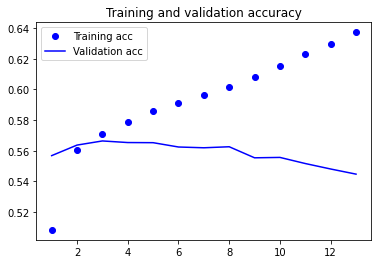

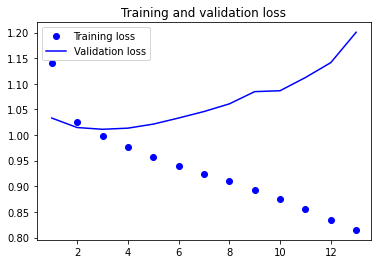

In [24]:
# ploting train and validation metrics results throu training epochs
import matplotlib.pyplot as plt

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

In [25]:
#df_test['review_text'] = df_test['review_text'].apply(lambda x: preprocessing(x, wordnet_lemmatizer, translator))

In [26]:
df_test = pd.read_csv("../input/goodreads-books-reviews-290312/goodreads_test.csv", usecols=test_cols, dtype=dtypes)

In [27]:
X_test = df_test['review_text'].values

In [28]:
n_most_common_words = 20000
max_len = 200
tokenizer = Tokenizer(num_words=n_most_common_words,
                      filters='1234567890!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(X_test)
sequences = tokenizer.texts_to_sequences(X_test)

X_test = pad_sequences(sequences, maxlen=max_len)

In [29]:
X_test.shape

(478033, 200)

In [30]:
y_pred = model.predict(X_test)
y_pred = np.argmax(y_pred, axis=1)

2022-09-23 09:37:24.287818: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 382426400 exceeds 10% of free system memory.


In [31]:
df_test["rating"] = y_pred
df_test[["review_id", "rating"]].to_csv("submission.csv", index=False)

In [32]:
from IPython.display import HTML
import pandas as pd
import numpy as np
import base64

# function that takes in a dataframe and creates a text link to  
# download it (will only work for files < 2MB or so)
def create_download_link(df, title = "Download CSV file", filename = "submission.csv"):  
    csv = df.to_csv(index=False)
    b64 = base64.b64encode(csv.encode())
    payload = b64.decode()
    html = '<a download="{filename}" href="data:text/csv;base64,{payload}" target="_blank">{title}</a>'
    html = html.format(payload=payload,title=title,filename=filename)
    return HTML(html)

In [33]:
create_download_link(df_test[["review_id", "rating"]])